## Performing Data Augmentation : -
### Methods I might be testing : -
    1. Time Stretching
    2. Pitch Shifting
    3. Noise Injection

In [ ]:
import os
import librosa
import numpy as np
import soundfile as sf
import librosa.display
import matplotlib.pyplot as plt
from IPython.display import display, Audio
from scipy.signal import lfilter, butter

/home/ziyadshaikh/miniconda3/envs/DNN/lib/python3.11/site-packages/lazy_loader/__init__.py:185: RuntimeWarning: subpackages can technically be lazily loaded, but it causes the package to be eagerly loaded even if it is already lazily loaded.So, you probably shouldn't use subpackages with this lazy feature.
  warnings.warn(msg, RuntimeWarning)
/home/ziyadshaikh/miniconda3/envs/DNN/lib/python3.11/site-packages/lazy_loader/__init__.py:185: RuntimeWarning: subpackages can technically be lazily loaded, but it causes the package to be eagerly loaded even if it is already lazily loaded.So, you probably shouldn't use subpackages with this lazy feature.
  warnings.warn(msg, RuntimeWarning)


In [ ]:
def augment_audio(y, sr, augment_type, alpha=0.5):
    if augment_type == 'time_stretching':
        rate = np.random.uniform(0.9, 1.1)  # Random stretching between 90% and 110%
        return librosa.effects.time_stretch(y, rate=rate)

    if augment_type == 'pitch_shifting':
        steps = np.random.randint(-2, 2)  # Random shift between -2 and 2 semitones
        return librosa.effects.pitch_shift(y, sr=sr, n_steps=steps)

    if augment_type == 'noise_injection':
        noise = np.random.randn(len(y))
        signal_power = np.sum(y**2)
        noise_power = np.sum(noise**2)
        ratio = signal_power / noise_power
        noisy = y + alpha * np.sqrt(ratio) * noise
        return noisy

In [ ]:
y, sr = librosa.load('/mnt/d/Projects/Datasets/mixture_audio_mono_pickup_mix/00_BN1-129-Eb_comp_mix.wav', sr=None)


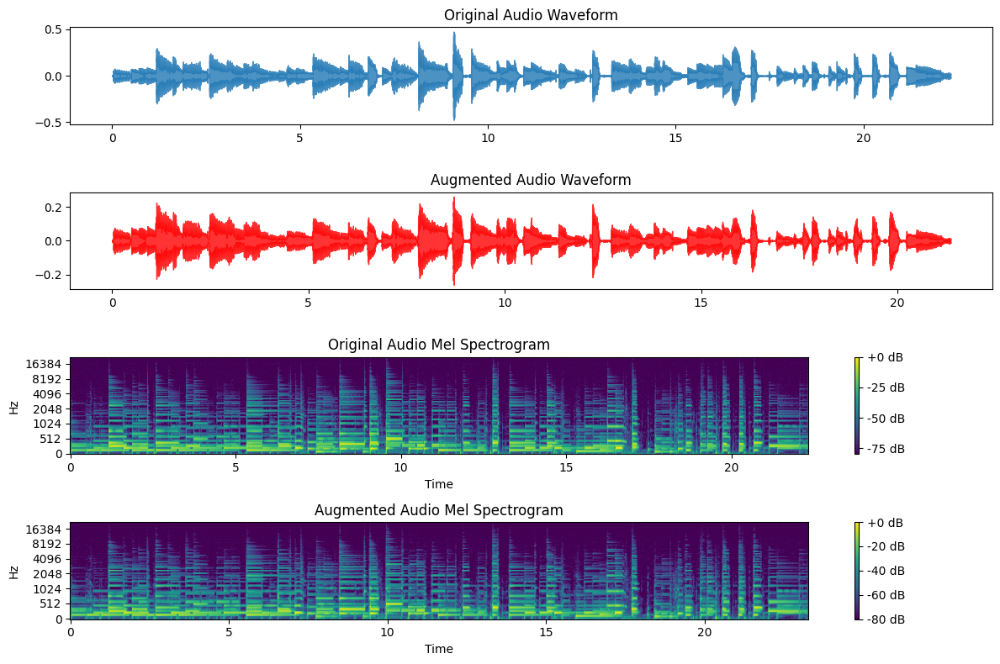

Original Audio:


Augmented Audio:


In [ ]:
# Load the audio
y, sr = librosa.load('/mnt/d/Projects/Datasets/mixture_audio_mono_pickup_mix/00_BN1-129-Eb_comp_mix.wav', sr=None)

# Augment the audio
augmented_y_TS = augment_audio(y, sr, 'time_stretching')

# Compute Mel spectrograms
original_mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
augmented_mel_spectrogram = librosa.feature.melspectrogram(y=augmented_y_TS, sr=sr)

# Convert Mel spectrograms to Decibels
original_mel_spectrogram_db = librosa.power_to_db(original_mel_spectrogram, ref=np.max)
augmented_mel_spectrogram_db = librosa.power_to_db(augmented_mel_spectrogram, ref=np.max)

plt.figure(figsize=(12, 8))

# Original Waveform
plt.subplot(4, 1, 1)
librosa.display.waveshow(y, sr=sr, alpha=0.8)
plt.title('Original Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Augmented Waveform
plt.subplot(4, 1, 2)
librosa.display.waveshow(augmented_y, sr=sr, alpha=0.8, color='r')
plt.title('Augmented with Time-St Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Original Mel Spectrogram
plt.subplot(4, 1, 3)
librosa.display.specshow(original_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Audio Mel Spectrogram')

# Augmented Mel Spectrogram
plt.subplot(4, 1, 4)
librosa.display.specshow(augmented_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Augmented Audio Mel Spectrogram')

plt.tight_layout()
plt.show()

# Display player for original and augmented audio
print("Original Audio:")
display(Audio(y, rate=sr))
print("Augmented Audio:")
display(Audio(augmented_y, rate=sr))

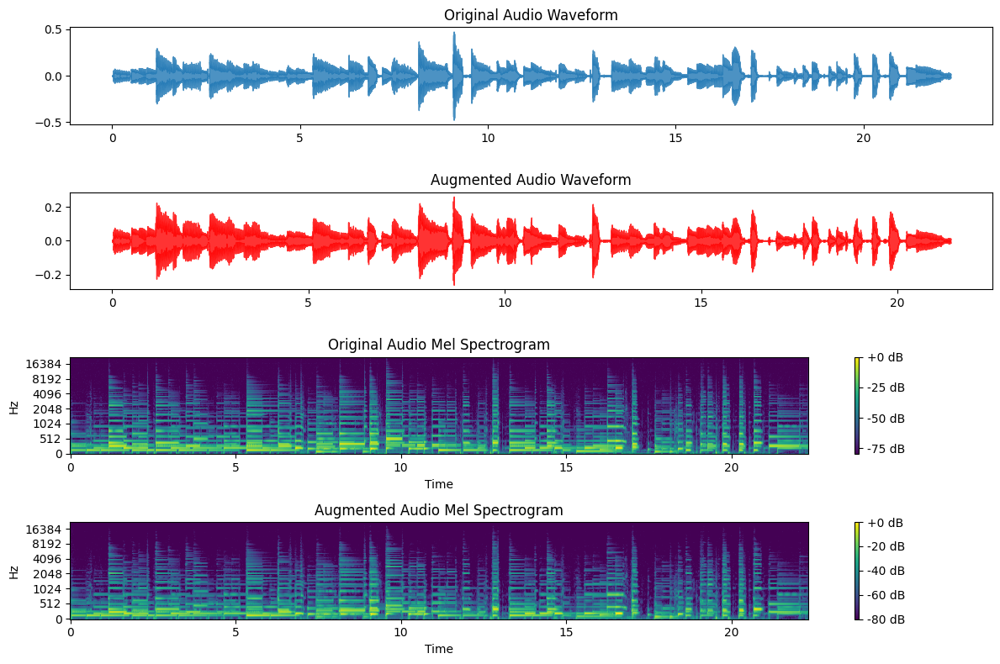

Original Audio:


Augmented Audio:


In [ ]:
# Augment the audio
augmented_y_PS = augment_audio(y, sr, 'pitch_shifting')

# Compute Mel spectrograms
original_mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
augmented_mel_spectrogram = librosa.feature.melspectrogram(y=augmented_y_PS, sr=sr)

# Convert Mel spectrograms to Decibels
original_mel_spectrogram_db = librosa.power_to_db(original_mel_spectrogram, ref=np.max)
augmented_mel_spectrogram_db = librosa.power_to_db(augmented_mel_spectrogram, ref=np.max)

plt.figure(figsize=(12, 8))

# Original Waveform
plt.subplot(4, 1, 1)
librosa.display.waveshow(y, sr=sr, alpha=0.8)
plt.title('Original Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Augmented Waveform
plt.subplot(4, 1, 2)
librosa.display.waveshow(augmented_y, sr=sr, alpha=0.8, color='r')
plt.title('Augmented Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Original Mel Spectrogram
plt.subplot(4, 1, 3)
librosa.display.specshow(original_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Audio Mel Spectrogram')

# Augmented Mel Spectrogram
plt.subplot(4, 1, 4)
librosa.display.specshow(augmented_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Augmented Audio Mel Spectrogram')

plt.tight_layout()
plt.show()

# Display player for original and augmented audio
print("Original Audio:")
display(Audio(y, rate=sr))
print("Augmented Audio:")
display(Audio(augmented_y_PS, rate=sr))

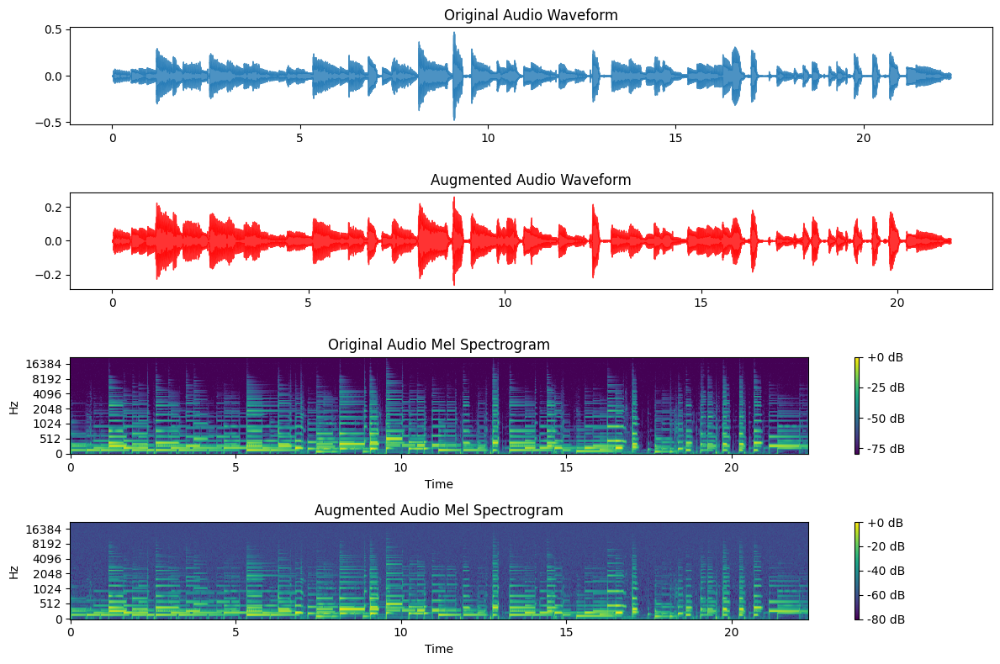

Original Audio:


Augmented Audio:


In [ ]:
# Augment the audio
augmented_y_NI = augment_audio(y, sr, 'noise_injection', alpha = 0.05)

# Compute Mel spectrograms
original_mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
augmented_mel_spectrogram = librosa.feature.melspectrogram(y=augmented_y_NI, sr=sr)

# Convert Mel spectrograms to Decibels
original_mel_spectrogram_db = librosa.power_to_db(original_mel_spectrogram, ref=np.max)
augmented_mel_spectrogram_db = librosa.power_to_db(augmented_mel_spectrogram, ref=np.max)

plt.figure(figsize=(12, 8))

# Original Waveform
plt.subplot(4, 1, 1)
librosa.display.waveshow(y, sr=sr, alpha=0.8)
plt.title('Original Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Augmented Waveform
plt.subplot(4, 1, 2)
librosa.display.waveshow(augmented_y, sr=sr, alpha=0.8, color='r')
plt.title('Augmented Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Original Mel Spectrogram
plt.subplot(4, 1, 3)
librosa.display.specshow(original_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Audio Mel Spectrogram')

# Augmented Mel Spectrogram
plt.subplot(4, 1, 4)
librosa.display.specshow(augmented_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Augmented Audio Mel Spectrogram')

plt.tight_layout()
plt.show()

# Display player for original and augmented audio
print("Original Audio:")
display(Audio(y, rate=sr))
print("Augmented Audio:")
display(Audio(augmented_y_NI, rate=sr))

This is a basic feed-forward compressor. Real-world audio compressors often have more sophisticated designs with additional features like lookahead, knee shape adjustments, etc. This example is meant to give you a starting point and a basic understanding of the process. Adjust the parameters as needed to achieve the desired amount of compression

### Time Stretching - (using harmonic-percussive separation like median filtering.)

Time Stretching with Harmonic-Percussive Separation: The idea is to separate the harmonic and percussive components of the audio, stretch them separately, and then combine them again. This can sometimes lead to more musically pleasing time-stretched results. Librosa provides a method for harmonic-percussive source separation using median filtering.

### Pitch Shifting - (Incorporating inharmonicity)

Pitch Shifting with Inharmonicity: The pitch shift often assumes that the harmonics of a note are integer multiples of the fundamental frequency. However, in real instruments, especially in string instruments, the harmonics can be slightly sharp, leading to a phenomenon called inharmonicity. While Librosa doesn't directly provide inharmonic pitch-shifting, we can simulate this by slightly altering the harmonic components of the audio after pitch shifting.

In [ ]:
def augment_audio_advanced(y, sr, augment_type):

    if augment_type == 'time_stretching':
        # Harmonic-Percussive separation
        y_harmonic, y_percussive = librosa.effects.hpss(y)

        # Stretching the components separately
        rate = np.random.uniform(0.9, 1.1)  # Random stretching between 90% and 110%
        y_harmonic_stretched = librosa.effects.time_stretch(y_harmonic, rate=rate)
        y_percussive_stretched = librosa.effects.time_stretch(y_percussive, rate=rate)

        # Combine them again
        y_stretched = y_harmonic_stretched + y_percussive_stretched
        return y_stretched

    if augment_type == 'pitch_shifting':
        # Pitch shifting
        steps = np.random.randint(-2, 2)  # Random shift between -2 and 2 semitones
        y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=steps)

        # Introducing inharmonicity by shifting the harmonic part a bit more
        y_harmonic, _ = librosa.effects.hpss(y_shifted)
        y_inharmonic = y_shifted + 0.0125 * librosa.effects.pitch_shift(y_harmonic, sr=sr, n_steps=steps)
        return y_inharmonic

    if augment_type == 'noise_injection':
        noise = np.random.randn(len(y))
        signal_power = np.sum(y**2)
        noise_power = np.sum(noise**2)
        ratio = signal_power / noise_power
        noisy = y + alpha * np.sqrt(ratio) * noise
        return noisy






In [ ]:
y, sr = librosa.load('/mnt/d/Projects/Datasets/mixture_audio_mono_pickup_mix/00_BN1-129-Eb_comp_mix.wav', sr=None)


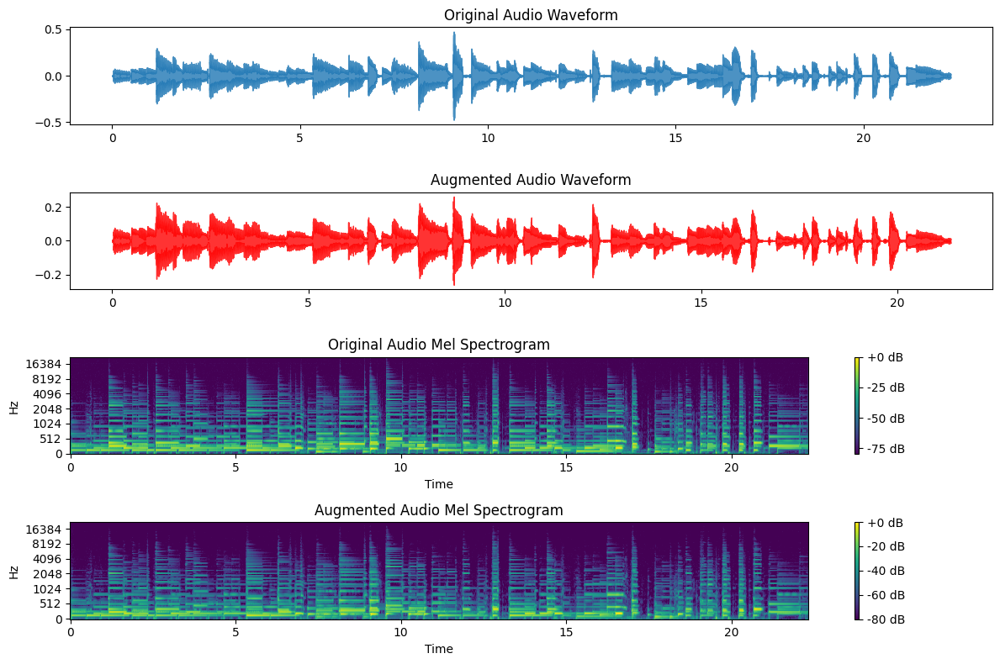

Original Audio:


Augmented Audio:


In [ ]:
# Augment the audio
augmented_y_PS_ad = augment_audio_advanced(y, sr, 'pitch_shifting')

# Compute Mel spectrograms
original_mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
augmented_mel_spectrogram = librosa.feature.melspectrogram(y=augmented_y_PS_ad, sr=sr)

# Convert Mel spectrograms to Decibels
original_mel_spectrogram_db = librosa.power_to_db(original_mel_spectrogram, ref=np.max)
augmented_mel_spectrogram_db = librosa.power_to_db(augmented_mel_spectrogram, ref=np.max)

plt.figure(figsize=(12, 8))

# Original Waveform
plt.subplot(4, 1, 1)
librosa.display.waveshow(y, sr=sr, alpha=0.8)
plt.title('Original Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Augmented Waveform
plt.subplot(4, 1, 2)
librosa.display.waveshow(augmented_y, sr=sr, alpha=0.8, color='r')
plt.title('Augmented Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Original Mel Spectrogram
plt.subplot(4, 1, 3)
librosa.display.specshow(original_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Audio Mel Spectrogram')

# Augmented Mel Spectrogram
plt.subplot(4, 1, 4)
librosa.display.specshow(augmented_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Augmented Audio Mel Spectrogram')

plt.tight_layout()
plt.show()

# Display player for original and augmented audio
print("Original Audio:")
display(Audio(y, rate=sr))
print("Augmented Audio:")
display(Audio(augmented_y_PS_ad, rate=sr))

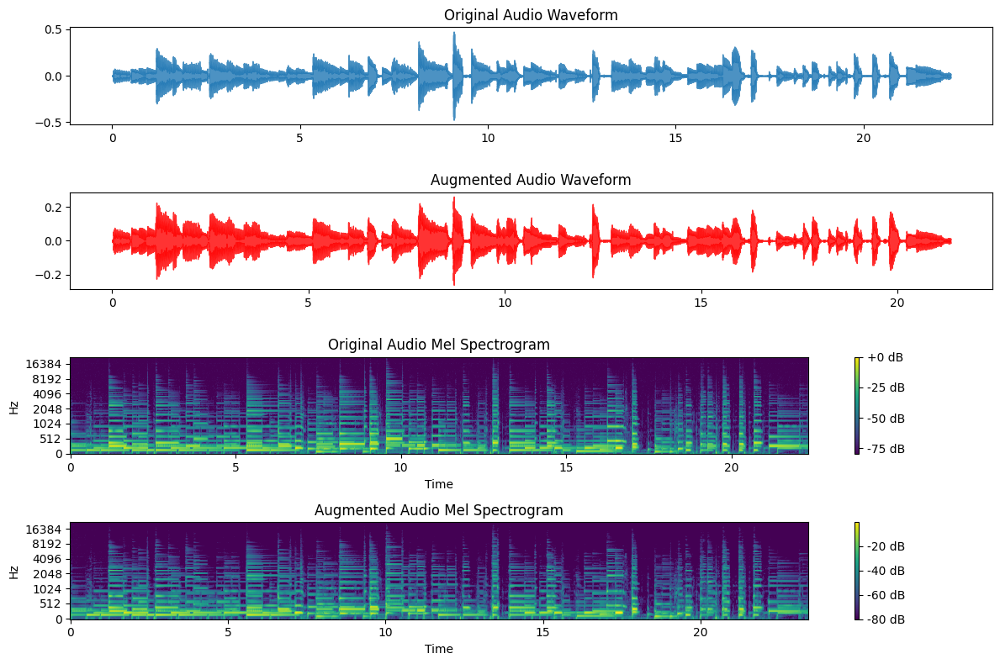

Original Audio:


Augmented Audio:


In [ ]:
# Augment the audio
augmented_y_TS_ad = augment_audio_advanced(y, sr, 'time_stretching')

# Compute Mel spectrograms
original_mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
augmented_mel_spectrogram = librosa.feature.melspectrogram(y=augmented_y_TS_ad, sr=sr)

# Convert Mel spectrograms to Decibels
original_mel_spectrogram_db = librosa.power_to_db(original_mel_spectrogram, ref=np.max)
augmented_mel_spectrogram_db = librosa.power_to_db(augmented_mel_spectrogram, ref=np.max)

plt.figure(figsize=(12, 8))

# Original Waveform
plt.subplot(4, 1, 1)
librosa.display.waveshow(y, sr=sr, alpha=0.8)
plt.title('Original Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Augmented Waveform
plt.subplot(4, 1, 2)
librosa.display.waveshow(augmented_y, sr=sr, alpha=0.8, color='r')
plt.title('Augmented Audio Waveform')
plt.xlabel(None)  # Remove x-axis label for clarity

# Original Mel Spectrogram
plt.subplot(4, 1, 3)
librosa.display.specshow(original_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Audio Mel Spectrogram')

# Augmented Mel Spectrogram
plt.subplot(4, 1, 4)
librosa.display.specshow(augmented_mel_spectrogram_db, sr=sr, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Augmented Audio Mel Spectrogram')

plt.tight_layout()
plt.show()

# Display player for original and augmented audio
print("Original Audio:")
display(Audio(y, rate=sr))
print("Augmented Audio:")
display(Audio(augmented_y_TS_ad, rate=sr))

### Noise Injection - (Check Noise in the data set)

The exact nature of the noise can sometimes be determined through both auditory inspection (listening) and various analytical tools.

Different types of noises include:

1. White noise: Has the same amplitude at any frequency. On a spectrogram, it appears as a consistent and uniform presence across all frequencies.
2. Pink noise: Has equal energy in each octave. It sounds deeper than white noise because it has more low-frequency components.
3. Brownian noise: Sounds even deeper than pink noise and has energy that decreases with the square of the frequency.
4. Impulse noise: Sudden and short noise bursts, like clicks or pops.
5. Hum: Usually related to power supply frequency (e.g., 50/60 Hz) and its harmonics.
6. Harmonic distortion: Results in additional harmonic frequencies that weren't present in the original signal.

Visual Inspection with Spectrograms: By plotting the spectrogram of your audio, you can visually inspect the frequency content over time.

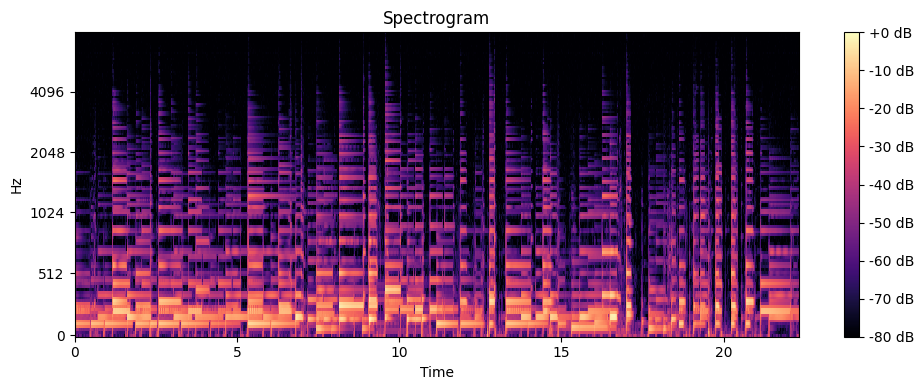

In [ ]:
S = librosa.feature.melspectrogram(y=y, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)
plt.figure(figsize=(10, 4))
librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.tight_layout()
plt.show()

In [ ]:
from scipy.stats import kurtosis, skew

# Compute kurtosis and skewness
k = kurtosis(y)
s = skew(y)

print(f"Kurtosis: {k:.5f}")
print(f"Skewness: {s:.5f}")

# Check for impulse noise based on kurtosis
if k > 3:  # 3 is the kurtosis of a normal distribution
    print("High kurtosis detected. Impulse noise might be present.")

Kurtosis: 3.01700
Skewness: -0.06109
High kurtosis detected. Impulse noise might be present.


Note: The threshold (3 in this case) is based on the kurtosis of a normal distribution. A kurtosis greater than 3 indicates a distribution with heavier tails than a normal distribution, which might indicate the presence of impulses or outliers in the signal. However, this is just a heuristic, and the actual threshold may vary depending on your specific dataset.

Impulse noise, also known as "spike noise" or "salt-and-pepper noise," refers to sudden and brief disturbances in a signal. It manifests as unexpected spikes or dips in an otherwise smooth waveform. The name "salt-and-pepper" is often used in the context of images where this noise appears as random white and black pixels, resembling grains of salt and pepper.

In audio signals, impulse noise might be heard as sudden clicks or pops. These can be introduced in various ways:

1. Analog Recording and Playback: Dust or scratches on vinyl records can produce a pop or click when the needle encounters them.
2. Digital Systems: Errors in data transmission or storage can result in bits being flipped, producing impulsive noise when played back.
3. Electrical Interference: Sudden electrical discharges or other interference can produce impulse noises in recorded audio.
4. Physical Disturbances: During recording, a sudden event, like dropping the microphone or tapping directly on it, can introduce impulse noise.

In statistical terms, a waveform affected by impulse noise will have a high kurtosis because of these extreme values (or outliers). Detecting and mitigating impulse noise is a common task in signal processing. There are various techniques to detect and remove impulse noise, depending on its nature and the application at hand.

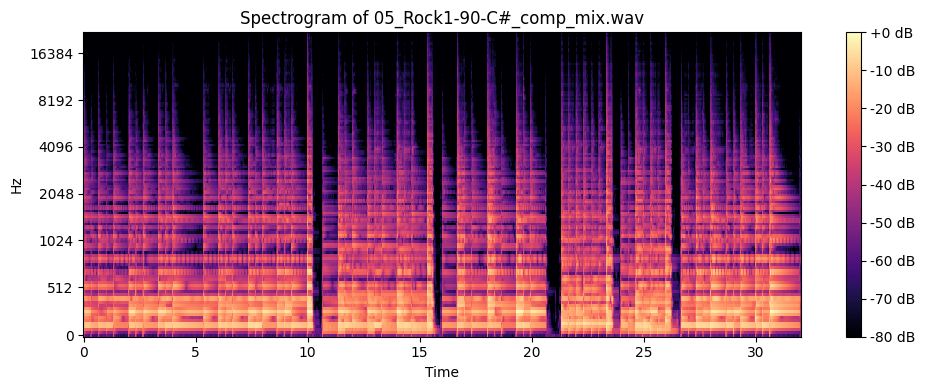

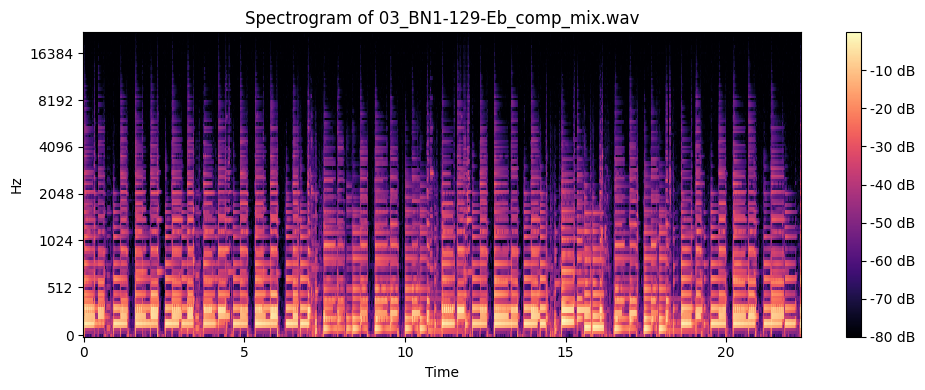

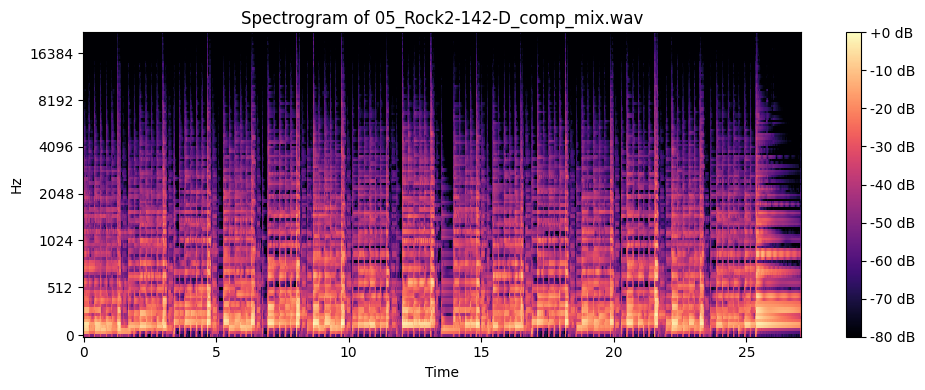

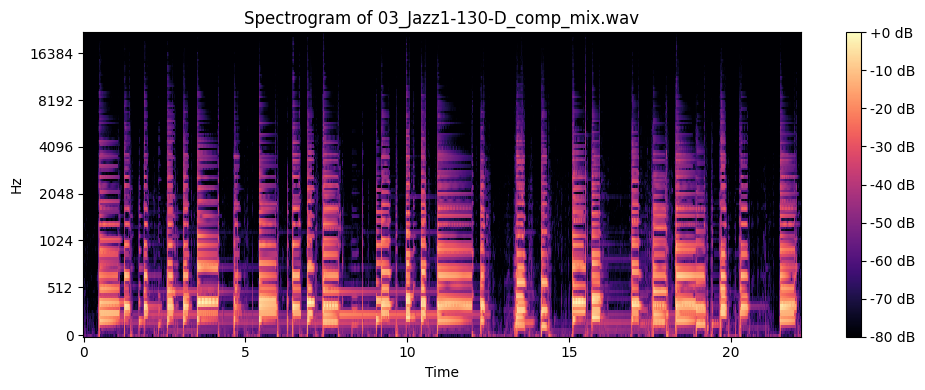

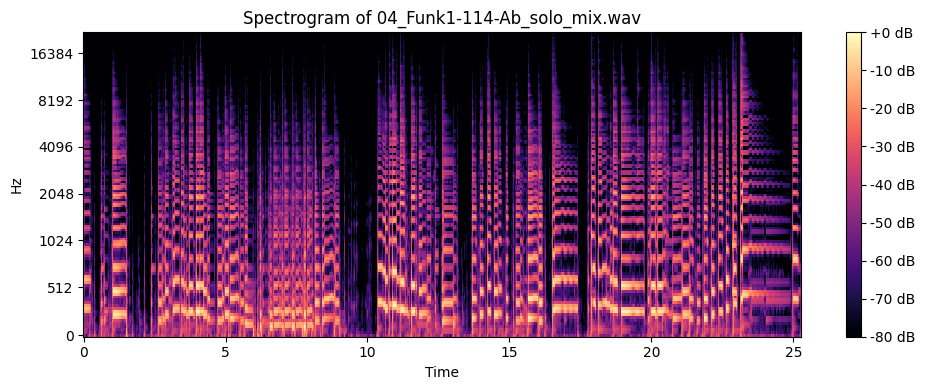

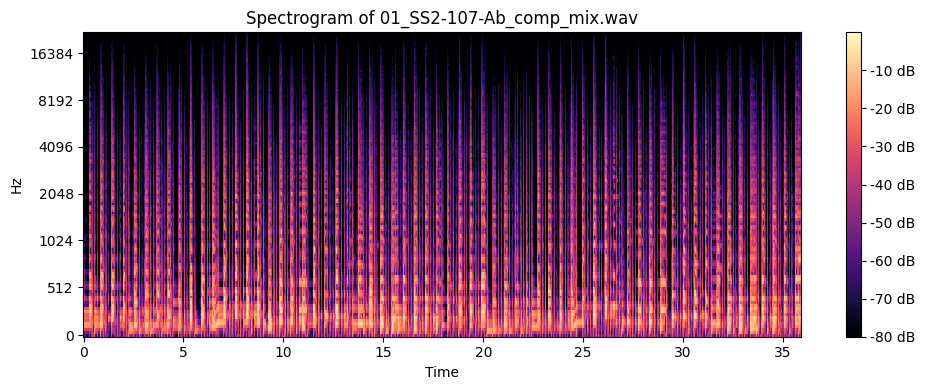

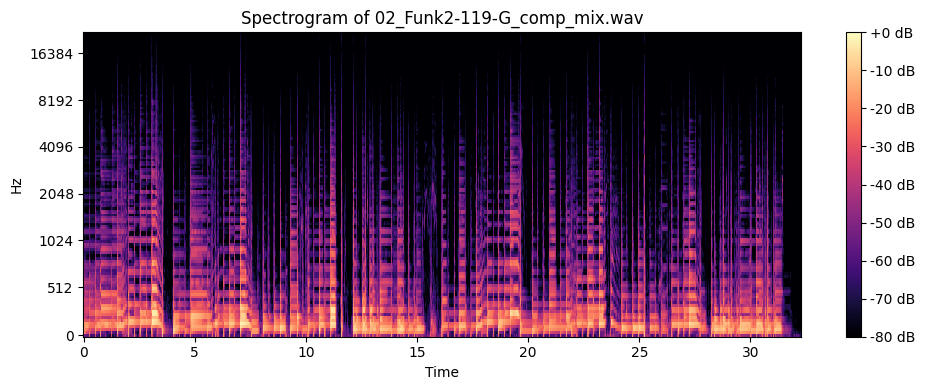

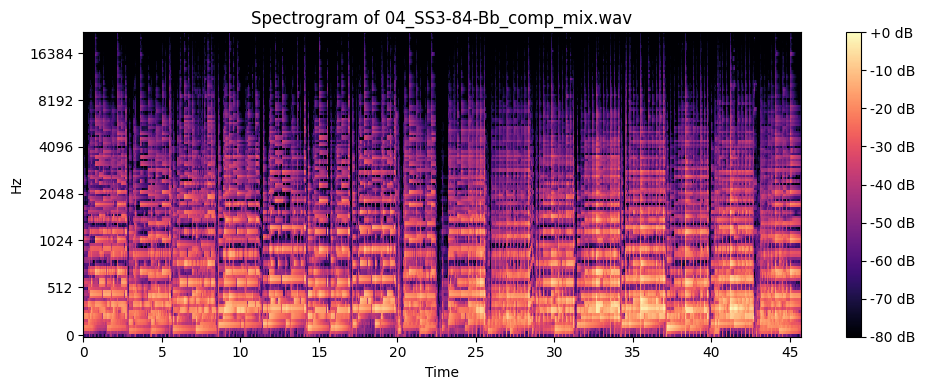

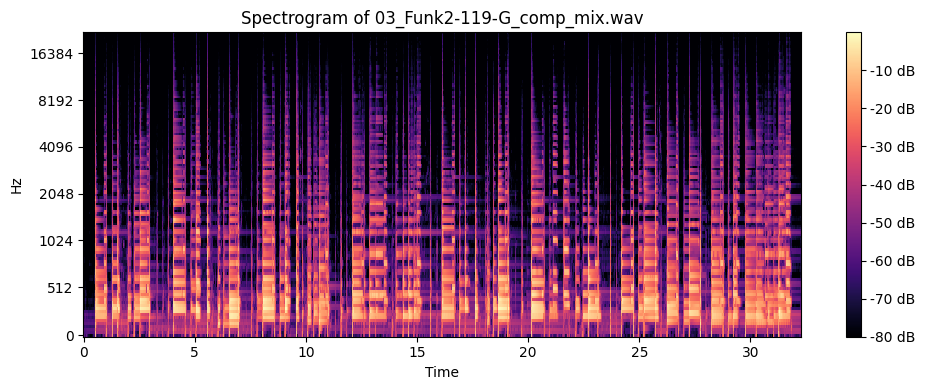

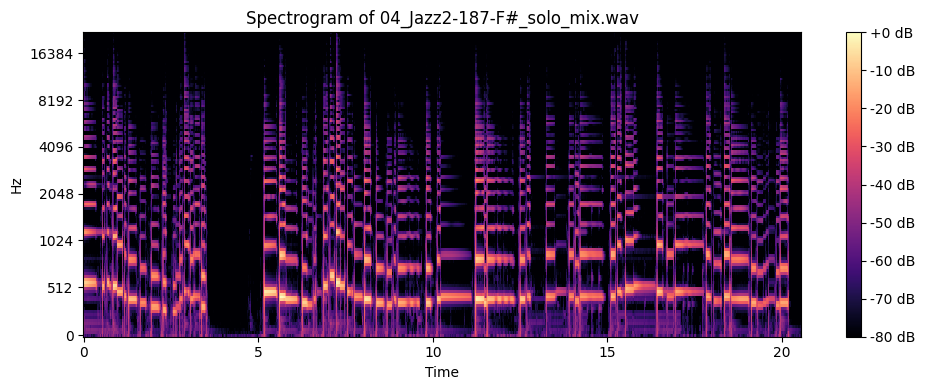

In [ ]:
import os
# Directory containing WAV files
wav_files_dir = '/mnt/d/Projects/Datasets/mixture_audio_mono_pickup_mix'

# Get all WAV files in the directory
all_files = [f for f in os.listdir(wav_files_dir) if f.endswith('.wav')]

# Randomly select a subset of files, say 10 for example
selected_files = np.random.choice(all_files, 10, replace=False)

for file in selected_files:
    # Load audio file
    y, sr = librosa.load(os.path.join(wav_files_dir, file), sr=None)

    # Compute the Mel spectrogram
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)

    # Convert Mel spectrogram to Decibels
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Plot
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(mel_spectrogram_db, x_axis='time', y_axis='mel', sr=sr)
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Spectrogram of {file}')
    plt.tight_layout()
    plt.show()

# Lets Create Data sets for augmentation


In [ ]:
def augment_audio_advanced(y, sr, augment_type):

    if augment_type == 'time_stretching':
        # Harmonic-Percussive separation
        y_harmonic, y_percussive = librosa.effects.hpss(y)

        # Stretching the components separately
        rate = np.random.uniform(0.9, 1.1)  # Random stretching between 90% and 110%
        y_harmonic_stretched = librosa.effects.time_stretch(y_harmonic, rate=rate)
        y_percussive_stretched = librosa.effects.time_stretch(y_percussive, rate=rate)

        # Combine them again
        y_stretched = y_harmonic_stretched + y_percussive_stretched
        return y_stretched

    if augment_type == 'pitch_shifting':
        # Pitch shifting
        steps = np.random.randint(-2, 2)  # Random shift between -2 and 2 semitones
        y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=steps)

        # Introducing inharmonicity by shifting the harmonic part a bit more
        y_harmonic, _ = librosa.effects.hpss(y_shifted)
        y_inharmonic = y_shifted + 0.0125 * librosa.effects.pitch_shift(y_harmonic, sr=sr, n_steps=steps)
        return y_inharmonic

    if augment_type == 'noise_injection':
        noise = np.random.randn(len(y))
        signal_power = np.sum(y**2)
        noise_power = np.sum(noise**2)
        ratio = signal_power / noise_power
        noisy = y + 0.05 * np.sqrt(ratio) * noise
        return noisy

In [ ]:
def augment_and_save_audio_files(input_dir, save_dir, augment_type):
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    for filename in os.listdir(input_dir):
        # Assuming you're dealing with .wav files
        if not filename.endswith('.wav'):
            continue

        y, sr = librosa.load(os.path.join(input_dir, filename), sr=None)

        # Perform augmentation
        augmented_y = augment_audio_advanced(y, sr, augment_type)

        # Save augmented audio
        save_path = os.path.join(save_dir, f"{filename.replace('.wav', '')}_{augment_type}.wav")
        sf.write(save_path, augmented_y, sr)

In [ ]:
def audio_files_to_spectrograms(input_dir, save_dir):
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    for filename in os.listdir(input_dir):
        if not filename.endswith('.wav'):
            continue

        y, sr = librosa.load(os.path.join(input_dir, filename), sr=None)
        spectrogram = librosa.stft(y)
        magnitude = np.abs(spectrogram)

        # Save magnitude spectrogram as numpy array
        save_path = os.path.join(save_dir, f"{filename.replace('.wav', '')}.npy")
        np.save(save_path, magnitude[:,:,np.newaxis])



In [ ]:
base_audio_dir_mix = "/mnt/d/Projects/Datasets/mixture_audio_mono_pickup_mix"
augment_types = ['time_stretching', 'pitch_shifting', 'noise_injection', 'dynamic_range_compression']

for augment_type in augment_types:
    augmented_audio_save_dir = os.path.join(base_audio_dir_mix, f"augmented_{augment_type}")
    augment_and_save_audio_files(base_audio_dir_mix, augmented_audio_save_dir, augment_type)

    spectrogram_save_dir = augmented_audio_save_dir.replace("mix", "spectrograms")
    audio_files_to_spectrograms(augmented_audio_save_dir, spectrogram_save_dir)


In [ ]:
base_audio_dir_hex = "/mnt/d/Projects/Datasets/audio_hex-pickup_debleeded"
augment_types = ['pitch_shifting', 'time_stretching', 'noise_injection']

for augment_type in augment_types:
    augmented_audio_save_dir = os.path.join(base_audio_dir_hex, f"augmented_{augment_type}")
    augment_and_save_audio_files(base_audio_dir_hex, augmented_audio_save_dir, augment_type)

    spectrogram_save_dir = augmented_audio_save_dir.replace("hex", "spectrograms")
    audio_files_to_spectrograms(augmented_audio_save_dir, spectrogram_save_dir)

In [ ]:
from scipy.ndimage import zoom

def resize_spectrogram(spectrogram, target_shape=(512, 128, 1)):
    """
    Resize the given spectrogram to the target shape.

    :param spectrogram: numpy array of shape (height, width, channels)
    :param target_shape: target shape for the resized spectrogram
    :return: resized spectrogram
    """

    # Calculate the zoom factors for each dimension
    zoom_factors = (target_shape[0] / spectrogram.shape[0],
                    target_shape[1] / spectrogram.shape[1],
                    target_shape[2] / spectrogram.shape[2])

    # Resize using zoom (interpolation)
    resized_spectrogram = zoom(spectrogram, zoom_factors)

    return resized_spectrogram



def resize_spectrograms_in_dir(src_dir, dest_dir):
    """
    Resize all spectrograms in the source directory and save to the destination directory.

    :param src_dir: directory containing the original spectrograms
    :param dest_dir: directory where resized spectrograms will be saved
    """

    if not os.path.exists(dest_dir):
        os.makedirs(dest_dir)

    for file_name in os.listdir(src_dir):
        if file_name.endswith('.npy'):
            file_path = os.path.join(src_dir, file_name)
            spectrogram = np.load(file_path)
            resized_spectrogram = resize_spectrogram(spectrogram)
            dest_path = os.path.join(dest_dir, file_name)
            np.save(dest_path, resized_spectrogram)

# Example Usage

# big_dir_tar_aug1 = '/mnt/d/Projects/Datasets/Datasets/hex_augmented_pitch_shifting'
# big_dir_tar_aug2 = '/mnt/d/Projects/Datasets/Datasets/hex_augmented_time_stretching'
# big_dir_inp_aug1 = '/mnt/d/Projects/Datasets/Datasets/mix_augmented_pitch_shifting'
# big_dir_inp_aug2 = '/mnt/d/Projects/Datasets/Datasets/mix_augmented_time_stretching'


# resized_input_dir_aug1 = "/mnt/d/Projects/Datasets/Datasets/mix_augmented_pitch_shifting_RESZ"
# resized_input_dir_aug2 = "/mnt/d/Projects/Datasets/Datasets/mix_augmented_time_stretching_RESZ"
# resized_target_dir_aug1 = "/mnt/d/Projects/Datasets/Datasets/hex_augmented_pitch_shifting_RESZ"
# resized_target_dir_aug2 = "/mnt/d/Projects/Datasets/Datasets/hex_augmented_time_stretching_RESZ"

# resize_spectrograms_in_dir(big_dir_tar_aug1, resized_target_dir_aug1)
# resize_spectrograms_in_dir(big_dir_tar_aug2, resized_target_dir_aug2)
# resize_spectrograms_in_dir(big_dir_inp_aug1, resized_input_dir_aug1)
# resize_spectrograms_in_dir(big_dir_inp_aug2, resized_input_dir_aug2)